In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install --pre pycaret

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
%matplotlib inline
import sklearn
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix,roc_curve, RocCurveDisplay
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn import svm
import tensorflow as tf
from tensorflow.keras import layers
import json

In [ ]:
from pycaret.classification import *

In [ ]:
json_path = "/content/drive/MyDrive/protein_props.json"
with open(json_path) as f:
  data = json.load(f)
len(data)

20434

In [ ]:
okk = pd.read_json(json_path)
properties = okk.transpose()

In [ ]:
druggable_data = "/content/drive/MyDrive/druggable_proteins.txt"
with open(druggable_data) as f:
  druggable_proteins = [line.strip() for line in f]
print(len(druggable_proteins))

approved_drugs = "/content/drive/MyDrive/approved_druggable_proteins.txt"
with open(approved_drugs) as g:
  approved_proteins = [line.strip() for line in g]
print(len(approved_proteins))

3345
2652


In [ ]:
index = 'A C D E F G H I K L M N P Q R S T V W Y'
for i in index.split(" "):
  properties[f"Amino_Acid_{i}_Percent"] = pd.Series([0]*properties.shape[0])
properties['Molar Extinction Coefficient 1'] = pd.Series([0]*properties.shape[0])
properties['Molar Extinction Coefficient 2'] = pd.Series([0]*properties.shape[0])
properties['Secondary Structure helix'] = pd.Series([0]*properties.shape[0])
properties['Secondary Structure turn'] = pd.Series([0]*properties.shape[0])
properties['Secondary Structure sheet'] = pd.Series([0]*properties.shape[0])
for i in range(properties.shape[0]):
  for j,k in properties['Amino Acid Percent'][i].items():
    properties[f"Amino_Acid_{j}_Percent"][i] = k
  properties['Molar Extinction Coefficient 1'][i] = properties['Molar Extinction Coefficient'][i][0]
  properties['Molar Extinction Coefficient 2'][i] = properties['Molar Extinction Coefficient'][i][1]
  properties['Secondary Structure helix'][i] = properties['Secondary Structure'][i][0]
  properties['Secondary Structure turn'][i] = properties['Secondary Structure'][i][1]
  properties['Secondary Structure sheet'][i] = properties['Secondary Structure'][i][2]
properties.drop(columns = ['Sequence','Amino Acid Count','Amino Acid Percent','Molar Extinction Coefficient','Secondary Structure'],axis = 1, inplace = True)

In [ ]:
is_druggable = []
for i in properties.index:
  if i in druggable_proteins:
    is_druggable.append(1)
  else:
    is_druggable.append(0)

approved_drugs = []
for j in properties.index:
  if j in approved_proteins:
    approved_drugs.append(1)
  else:
    approved_drugs.append(0)

properties['is_druggable'] = is_druggable
properties['is_approved'] = approved_drugs
properties


,Sequence Length,Molecular Weight,GRAVY,Isoelectric Point,Instability Index,Aromaticity,Flexibility,Charge at 7,Amino_Acid_A_Percent,Amino_Acid_C_Percent,...,Amino_Acid_V_Percent,Amino_Acid_W_Percent,Amino_Acid_Y_Percent,Molar Extinction Coefficient 1,Molar Extinction Coefficient 2,Secondary Structure helix,Secondary Structure turn,Secondary Structure sheet,is_druggable,is_approved
A0A087X1C5,515,57488.0269,-0.016117,8.703506,45.155922,0.085437,"[0.977440476190476, 0.9806071428571421, 0.9983...",5.889114,0.081553,0.017476,...,0.085437,0.013592,0.011650,47440.0,47940.0,0.314563,0.262136,0.378641,0,0
A0A0B4J2F0,54,6313.3024,-0.235185,8.03542,55.518519,0.12963,"[0.982095238095238, 0.95625, 0.983214285714285...",0.510326,0.074074,0.000000,...,0.074074,0.000000,0.037037,2980.0,2980.0,0.444444,0.129630,0.388889,0,0
A0A0B4J2F2,783,84929.1856,-0.197957,6.813029,59.277803,0.063857,"[1.00125, 0.970071428571428, 1.034523809523809...",-1.004586,0.084291,0.024266,...,0.053640,0.007663,0.020434,56840.0,57965.0,0.314176,0.312899,0.328225,0,0
A0A0C5B5G6,16,2174.5917,-0.9375,10.266413,77.300625,0.25,"[0.9704047619047621, 1.00345238095238, 0.95860...",2.500138,0.000000,0.000000,...,0.000000,0.062500,0.125000,8480.0,8480.0,0.312500,0.125000,0.375000,0,0
A0A0K2S4Q6,201,21805.9293,0.10796,5.366988,41.796517,0.074627,"[1.008285714285714, 0.9868928571428571, 0.991,...",-3.378625,0.054726,0.039801,...,0.079602,0.024876,0.019900,33460.0,33960.0,0.283582,0.308458,0.402985,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Q9UI54,55,6386.613,0.303636,10.302902,35.789091,0.145455,"[0.9746904761904761, 1.00325, 0.98202380952380...",7.571427,0.018182,0.018182,...,0.054545,0.000000,0.036364,2980.0,2980.0,0.290909,0.218182,0.527273,0,0
Q9UI72,69,8249.2539,-1.015942,9.348383,46.171014,0.101449,"[1.006333333333333, 0.9435238095238091, 0.9573...",3.659009,0.057971,0.043478,...,0.014493,0.028986,0.043478,15470.0,15595.0,0.304348,0.246377,0.275362,0,0
Q9Y3F1,56,6534.5215,0.444643,4.493088,69.675,0.196429,"[0.988154761904761, 0.9863214285714281, 0.9781...",-2.5132,0.035714,0.035714,...,0.017857,0.035714,0.053571,15470.0,15595.0,0.303571,0.232143,0.535714,0,0
Q9Y6C7,94,11023.7471,-0.029787,10.192468,62.375638,0.117021,"[0.9616666666666661, 1.001988095238095, 0.9683...",6.176832,0.042553,0.021277,...,0.031915,0.042553,0.021277,24980.0,25105.0,0.319149,0.244681,0.436170,0,0


In [ ]:
data = properties.drop(['Flexibility'],axis = 1)
data

,Sequence Length,Molecular Weight,GRAVY,Isoelectric Point,Instability Index,Aromaticity,Charge at 7,Amino_Acid_A_Percent,Amino_Acid_C_Percent,Amino_Acid_D_Percent,...,Amino_Acid_V_Percent,Amino_Acid_W_Percent,Amino_Acid_Y_Percent,Molar Extinction Coefficient 1,Molar Extinction Coefficient 2,Secondary Structure helix,Secondary Structure turn,Secondary Structure sheet,is_druggable,is_approved
A0A087X1C5,515,57488.0269,-0.016117,8.703506,45.155922,0.085437,5.889114,0.081553,0.017476,0.044660,...,0.085437,0.013592,0.011650,47440.0,47940.0,0.314563,0.262136,0.378641,0,0
A0A0B4J2F0,54,6313.3024,-0.235185,8.03542,55.518519,0.12963,0.510326,0.074074,0.000000,0.018519,...,0.074074,0.000000,0.037037,2980.0,2980.0,0.444444,0.129630,0.388889,0,0
A0A0B4J2F2,783,84929.1856,-0.197957,6.813029,59.277803,0.063857,-1.004586,0.084291,0.024266,0.038314,...,0.053640,0.007663,0.020434,56840.0,57965.0,0.314176,0.312899,0.328225,0,0
A0A0C5B5G6,16,2174.5917,-0.9375,10.266413,77.300625,0.25,2.500138,0.000000,0.000000,0.000000,...,0.000000,0.062500,0.125000,8480.0,8480.0,0.312500,0.125000,0.375000,0,0
A0A0K2S4Q6,201,21805.9293,0.10796,5.366988,41.796517,0.074627,-3.378625,0.054726,0.039801,0.034826,...,0.079602,0.024876,0.019900,33460.0,33960.0,0.283582,0.308458,0.402985,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Q9UI54,55,6386.613,0.303636,10.302902,35.789091,0.145455,7.571427,0.018182,0.018182,0.000000,...,0.054545,0.000000,0.036364,2980.0,2980.0,0.290909,0.218182,0.527273,0,0
Q9UI72,69,8249.2539,-1.015942,9.348383,46.171014,0.101449,3.659009,0.057971,0.043478,0.028986,...,0.014493,0.028986,0.043478,15470.0,15595.0,0.304348,0.246377,0.275362,0,0
Q9Y3F1,56,6534.5215,0.444643,4.493088,69.675,0.196429,-2.5132,0.035714,0.035714,0.000000,...,0.017857,0.035714,0.053571,15470.0,15595.0,0.303571,0.232143,0.535714,0,0
Q9Y6C7,94,11023.7471,-0.029787,10.192468,62.375638,0.117021,6.176832,0.042553,0.021277,0.010638,...,0.031915,0.042553,0.021277,24980.0,25105.0,0.319149,0.244681,0.436170,0,0


In [ ]:
data[data.columns[0:7]] = data[data.columns[0:7]].astype(float)
print(data.info())

<class 'pandas.core.frame.DataFrame'>
Index: 20434 entries, A0A087X1C5 to Q9Y6Z2
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Sequence Length                 20434 non-null  float64
 1   Molecular Weight                20434 non-null  float64
 2   GRAVY                           20434 non-null  float64
 3   Isoelectric Point               20434 non-null  float64
 4   Instability Index               20434 non-null  float64
 5   Aromaticity                     20434 non-null  float64
 6   Charge at 7                     20434 non-null  float64
 7   Amino_Acid_A_Percent            20434 non-null  float64
 8   Amino_Acid_C_Percent            20434 non-null  float64
 9   Amino_Acid_D_Percent            20434 non-null  float64
 10  Amino_Acid_E_Percent            20434 non-null  float64
 11  Amino_Acid_F_Percent            20434 non-null  float64
 12  Amino_Acid_G_Percent       

In [ ]:
data.isna().sum().sum()

0

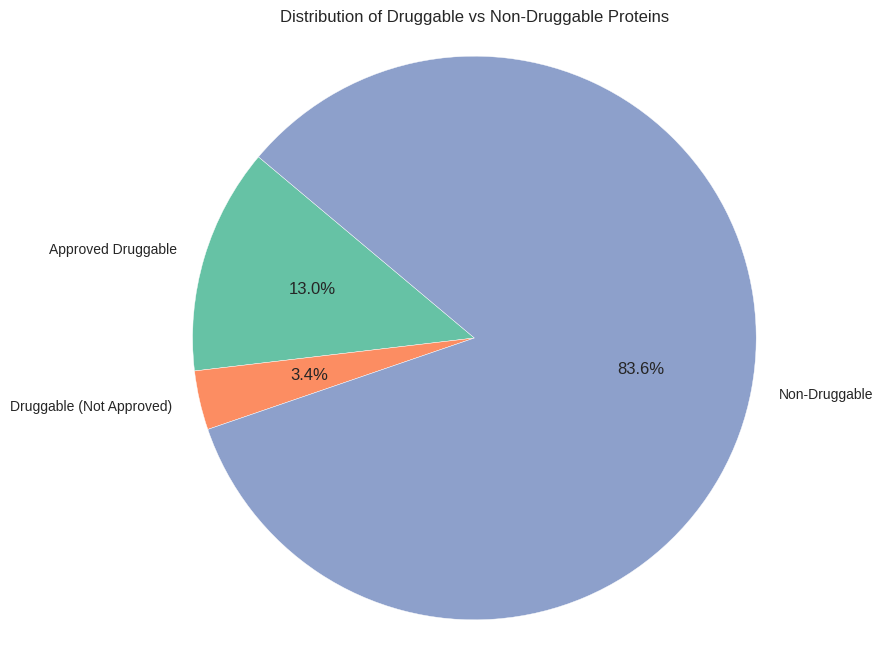

In [ ]:
druggable_counts = properties['is_druggable'].value_counts()

druggable_df = properties[properties['is_druggable'] == 1]
approved_druggable_count = druggable_df['is_approved'].sum()

total_proteins = properties.shape[0]

non_druggable_count = total_proteins - druggable_counts[1]
non_approved_druggable_count = druggable_counts[1] - approved_druggable_count

# Plotting
plt.figure(figsize=(8, 8))
plt.pie([approved_druggable_count, non_approved_druggable_count, non_druggable_count], labels=['Approved Druggable', 'Druggable (Not Approved)', 'Non-Druggable'], autopct='%1.1f%%', startangle=140, colors=['#66c2a5', '#fc8d62', '#8da0cb'])
plt.title('Distribution of Druggable vs Non-Druggable Proteins')
plt.axis('equal')
plt.show()

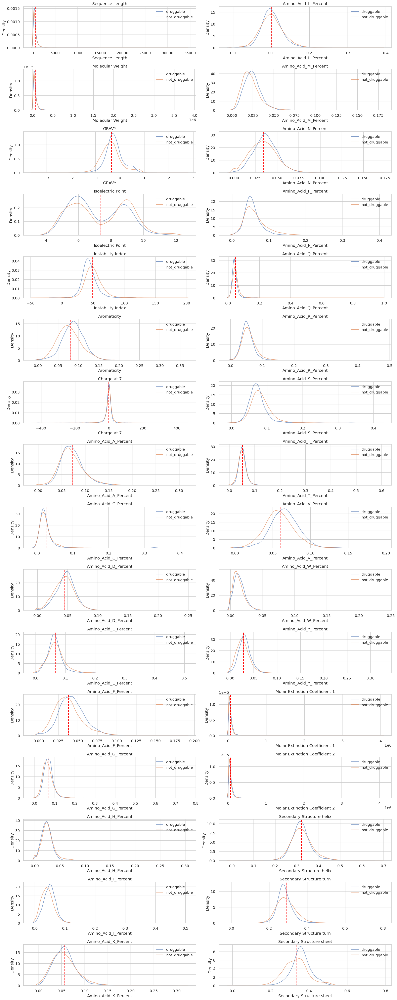

In [ ]:
fig,ax = plt.subplots(figsize = (20,50),nrows = 16,ncols = 2)
for i,values in enumerate(data.columns[:-2]):
  if i <16:
    sns.kdeplot(data=data, x=values, ax=ax[i][0],alpha = 0.7,common_norm = True, label = 'druggable')
    sns.kdeplot(data=data[data['is_druggable'] == 1], x=values, ax=ax[i][0],alpha = 0.7,common_norm = True, label = 'druggable')
    sns.kdeplot(data = data[data['is_druggable'] == 0], x=values, ax=ax[i][0],alpha = 0.7,common_norm = True, label ='not_druggable')
    ax[i][0].axvline(data[values].mean(), color='red', linestyle='dashed', linewidth=2)
    ax[i][0].set_title(values)
    ax[i][0].legend()
  else:
    sns.kdeplot(data=data[data['is_druggable'] == 1], x=values, ax=ax[i-16][1],alpha = 0.7,common_norm = True,label = 'druggable')
    sns.kdeplot(data=data[data['is_druggable'] == 0], x=values, ax=ax[i-16][1],alpha = 0.7,common_norm = True,label ='not_druggable')
    ax[i-16][1].axvline(data[values].mean(), color='red', linestyle='dashed', linewidth=2)
    ax[i-16][1].set_title(values)
    ax[i-16][1].legend()

plt.tight_layout()
plt.show()

In [ ]:
data.describe()

,Sequence Length,Molecular Weight,GRAVY,Isoelectric Point,Instability Index,Aromaticity,Charge at 7,Amino_Acid_A_Percent,Amino_Acid_C_Percent,Amino_Acid_D_Percent,...,Amino_Acid_V_Percent,Amino_Acid_W_Percent,Amino_Acid_Y_Percent,Molar Extinction Coefficient 1,Molar Extinction Coefficient 2,Secondary Structure helix,Secondary Structure turn,Secondary Structure sheet,is_druggable,is_approved
count,20434.000000,2.043400e+04,20434.000000,20434.000000,20434.000000,20434.000000,20434.000000,20434.000000,20434.000000,20434.000000,...,20434.000000,20434.000000,20434.000000,2.043400e+04,2.043400e+04,20434.000000,20434.000000,20434.000000,20434.000000,20434.000000
mean,558.350152,6.218838e+04,-0.343600,7.329772,49.419399,0.079209,-1.912736,0.072052,0.025376,0.045246,...,0.059924,0.013143,0.027888,5.938539e+04,6.015646e+04,0.320547,0.289585,0.335513,0.163698,0.129784
std,606.567158,6.708417e+04,0.430772,1.754309,13.373352,0.030165,22.825295,0.027747,0.026146,0.017634,...,0.019620,0.009426,0.015154,6.554780e+04,6.626062e+04,0.054092,0.053513,0.069216,0.370010,0.336074
min,2.000000,2.602869e+02,-3.432500,4.050028,-42.940000,0.000000,-447.417559,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,249.000000,2.775125e+04,-0.604473,5.802119,40.892744,0.058824,-8.026765,0.053946,0.013058,0.033898,...,0.047138,0.006500,0.018116,2.487000e+04,2.521875e+04,0.289855,0.255047,0.292308,0.000000,0.000000
50%,415.000000,4.619810e+04,-0.362563,7.059653,48.131515,0.077367,0.213363,0.068340,0.020528,0.045356,...,0.059211,0.011538,0.026743,4.446000e+04,4.518500e+04,0.318111,0.283897,0.337271,0.000000,0.000000
75%,670.000000,7.482271e+04,-0.131380,8.885194,56.548763,0.097046,7.268414,0.085911,0.030172,0.055556,...,0.071983,0.017857,0.035912,7.483000e+04,7.577500e+04,0.349491,0.318875,0.374579,0.000000,0.000000
max,34350.000000,3.815983e+06,2.608000,11.999968,196.717500,0.357143,457.297097,0.307229,0.411765,0.242424,...,0.188525,0.232877,0.321429,4.051510e+06,4.083510e+06,0.676471,0.779400,0.760000,1.000000,1.000000


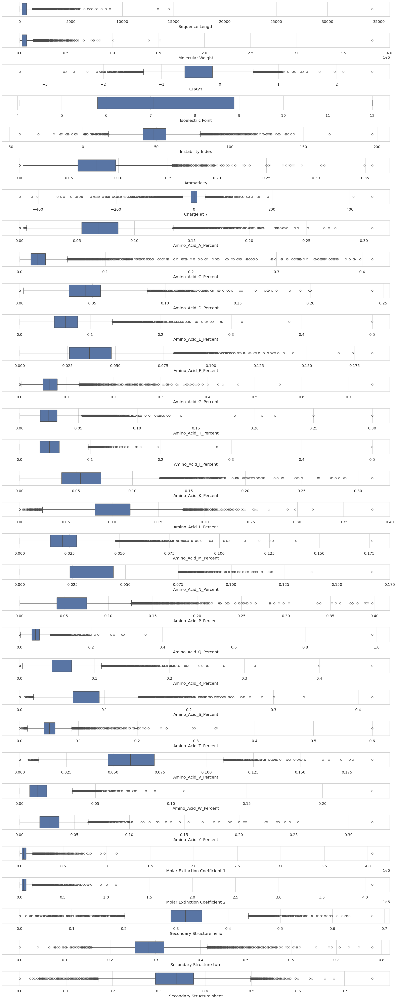

In [ ]:
fig,ax = plt.subplots(figsize = (20,50), nrows = 32)
for i,values in enumerate(data.columns[:-2]):
  sns.boxplot(data[values], orient = 'h',ax = ax[i])
plt.tight_layout()
plt.show()

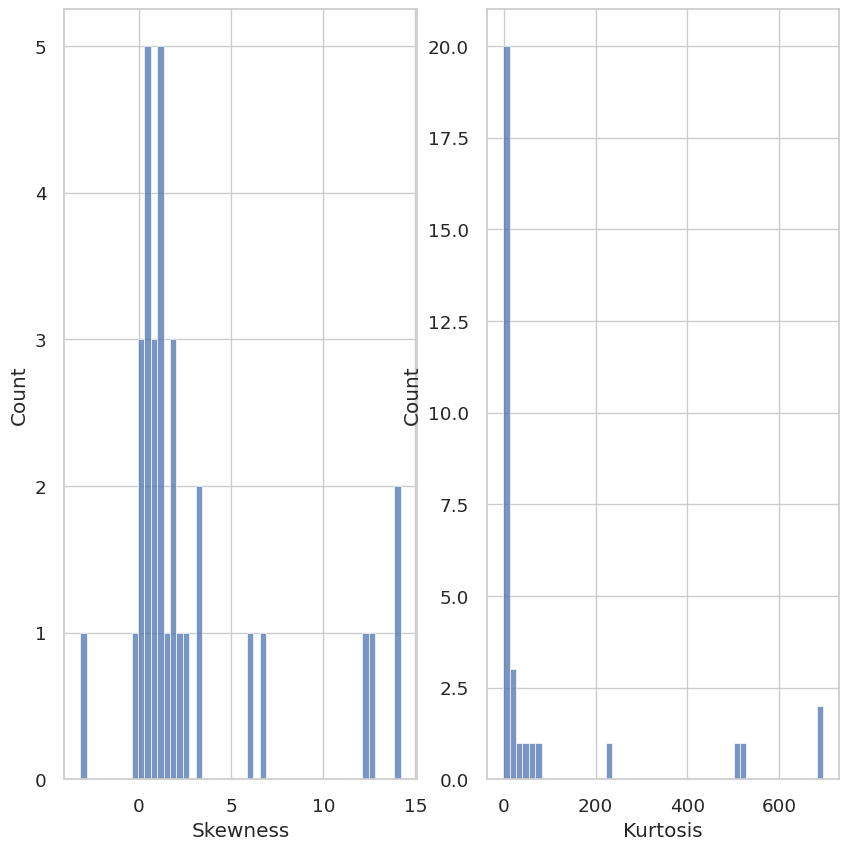

In [ ]:
okk = {
    "Skewness" : pd.Series(data[data.columns[:-2]].skew()),
    "Kurtosis" : pd.Series(data[data.columns[:-2]].kurtosis())
}
stats = pd.DataFrame(okk)
fig,ax = plt.subplots(figsize = (10,10),ncols = 2)
sns.histplot(stats['Skewness'],bins = 50, ax =ax[0])
sns.histplot(stats['Kurtosis'],bins = 50, ax =ax[1])
plt.show()

In [ ]:
normalized_need_column = stats[(abs(stats["Skewness"]) > 2.5) & (stats['Kurtosis'] > 10)]
normalized_need_column

,Skewness,Kurtosis
Sequence Length,12.467282,513.166402
Molecular Weight,12.396958,516.335435
Charge at 7,-3.166890,61.028859
Amino_Acid_C_Percent,6.660513,69.495041
Amino_Acid_G_Percent,3.290374,33.704503
Amino_Acid_Q_Percent,6.181852,224.694268
Amino_Acid_T_Percent,3.206956,54.074455
Molar Extinction Coefficient 1,14.193814,695.545705
Molar Extinction Coefficient 2,14.113224,687.684901


In [ ]:
# data[data.columns[:-2]] = np.log1p(data[data.columns[:-2]])
# data

In [ ]:
# fig,ax = plt.subplots(figsize = (20,50),nrows = 16,ncols = 2)
# for i,values in enumerate(data.columns[:-2]):
#   if i <16:
#     sns.kdeplot(data=data[data['is_druggable'] == 1], x=values, ax=ax[i][0],alpha = 0.7,common_norm = True, label = 'druggable')
#     sns.kdeplot(data = data[data['is_druggable'] == 0], x=values, ax=ax[i][0],alpha = 0.7,common_norm = True, label ='not_druggable')
#     ax[i][0].axvline(data[values].mean(), color='red', linestyle='dashed', linewidth=2)
#     ax[i][0].set_title(values)
#     ax[i][0].legend()
#   else:
#     sns.kdeplot(data=data[data['is_druggable'] == 1], x=values, ax=ax[i-16][1],alpha = 0.7,common_norm = True,label = 'druggable')
#     sns.kdeplot(data=data[data['is_druggable'] == 0], x=values, ax=ax[i-16][1],alpha = 0.7,common_norm = True,label ='not_druggable')
#     ax[i-16][1].axvline(data[values].mean(), color='red', linestyle='dashed', linewidth=2)
#     ax[i-16][1].set_title(values)
#     ax[i-16][1].legend()

# plt.tight_layout()
# plt.show()

In [ ]:
#scaling of data on same scale for further analysis(Z-score normalization)
std_scale = StandardScaler()
data[data.columns[:-2]] = std_scale.fit_transform(data[data.columns[:-2]])
data

,Sequence Length,Molecular Weight,GRAVY,Isoelectric Point,Instability Index,Aromaticity,Charge at 7,Amino_Acid_A_Percent,Amino_Acid_C_Percent,Amino_Acid_D_Percent,...,Amino_Acid_V_Percent,Amino_Acid_W_Percent,Amino_Acid_Y_Percent,Molar Extinction Coefficient 1,Molar Extinction Coefficient 2,Secondary Structure helix,Secondary Structure turn,Secondary Structure sheet,is_druggable,is_approved
A0A087X1C5,-0.071470,-0.070068,0.760243,0.783081,-0.318812,0.206465,0.341816,0.342421,-0.302177,-0.033219,...,1.300386,0.047635,-1.071593,-0.182244,-0.184374,-0.110627,-0.512963,0.623100,0,0
A0A0B4J2F0,-0.831503,-0.832930,0.251681,0.402247,0.456076,1.671528,0.106160,0.072864,-0.970587,-1.515677,...,0.721231,-1.394374,0.603738,-0.860544,-0.862924,2.290542,-2.989190,0.771163,0,0
A0A0B4J2F2,0.370372,0.338997,0.338107,-0.294564,0.737186,-0.508946,0.039788,0.441092,-0.042476,-0.393093,...,-0.320287,-0.581419,-0.491929,-0.038834,-0.033074,-0.117779,0.435680,-0.105303,0,0
A0A0C5B5G6,-0.894152,-0.894626,-1.378722,1.673999,2.084886,5.662007,0.193337,-2.596787,-0.970587,-2.565837,...,-3.054272,5.236294,6.408663,-0.776634,-0.779916,-0.148769,-3.075707,0.570499,0,0
A0A0K2S4Q6,-0.589150,-0.601982,1.048284,-1.118863,-0.570019,-0.151906,-0.064224,-0.624433,0.551718,-0.590910,...,1.002985,1.244698,-0.527151,-0.395529,-0.395365,-0.683386,0.352681,0.974823,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Q9UI54,-0.829854,-0.831837,1.502540,1.694799,-1.019239,2.196150,0.415521,-1.941509,-0.275170,-2.565837,...,-0.274129,-1.394374,0.559298,-0.860544,-0.862924,-0.547929,-1.334360,2.770513,0,0
Q9UI72,-0.806773,-0.804071,-1.560823,1.150686,-0.242906,0.737302,0.244110,-0.507495,0.692366,-0.922108,...,-2.315587,1.680718,1.028813,-0.669991,-0.672534,-0.299481,-0.807463,-0.869052,0,0
Q9Y3F1,-0.828206,-0.829633,1.829883,-1.617020,1.514661,3.886024,-0.026308,-1.309634,0.395410,-2.565837,...,-2.144106,2.394579,1.694889,-0.669991,-0.672534,-0.313835,-1.073462,2.892476,0,0
Q9Y6C7,-0.765557,-0.762712,0.728507,1.631847,0.968834,1.253540,0.354421,-1.063158,-0.156801,-1.962553,...,-1.427593,3.120123,-0.436338,-0.524903,-0.529007,-0.025847,-0.839157,1.454277,0,0


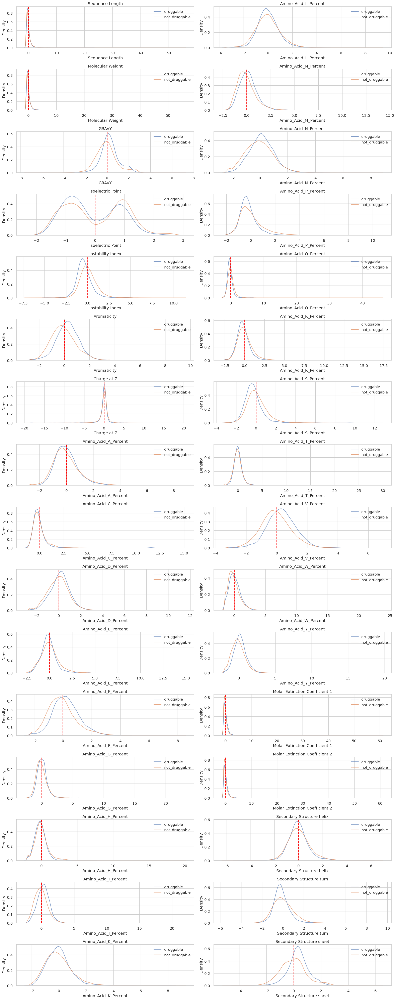

In [ ]:
fig,ax = plt.subplots(figsize = (20,50),nrows = 16,ncols = 2)
for i,values in enumerate(data.columns[:-2]):
  if i <16:
    sns.kdeplot(data=data[data['is_druggable'] == 1], x=values, ax=ax[i][0],alpha = 0.7,common_norm = True, label = 'druggable')
    sns.kdeplot(data = data[data['is_druggable'] == 0], x=values, ax=ax[i][0],alpha = 0.7,common_norm = True, label ='not_druggable')
    ax[i][0].axvline(data[values].mean(), color='red', linestyle='dashed', linewidth=2)
    ax[i][0].set_title(values)
    ax[i][0].legend()
  else:
    sns.kdeplot(data=data[data['is_druggable'] == 1], x=values, ax=ax[i-16][1],alpha = 0.7,common_norm = True,label = 'druggable')
    sns.kdeplot(data=data[data['is_druggable'] == 0], x=values, ax=ax[i-16][1],alpha = 0.7,common_norm = True,label ='not_druggable')
    ax[i-16][1].axvline(data[values].mean(), color='red', linestyle='dashed', linewidth=2)
    ax[i-16][1].set_title(values)
    ax[i-16][1].legend()

plt.tight_layout()
plt.show()

In [ ]:
okk_1 = data
#lets explore deep in feature set and their selection
sns.set_style('ticks')
sns.pairplot(okk_1.iloc[:100],hue = "is_druggable")
plt.title("Correlation Status between features considered")
plt.show()

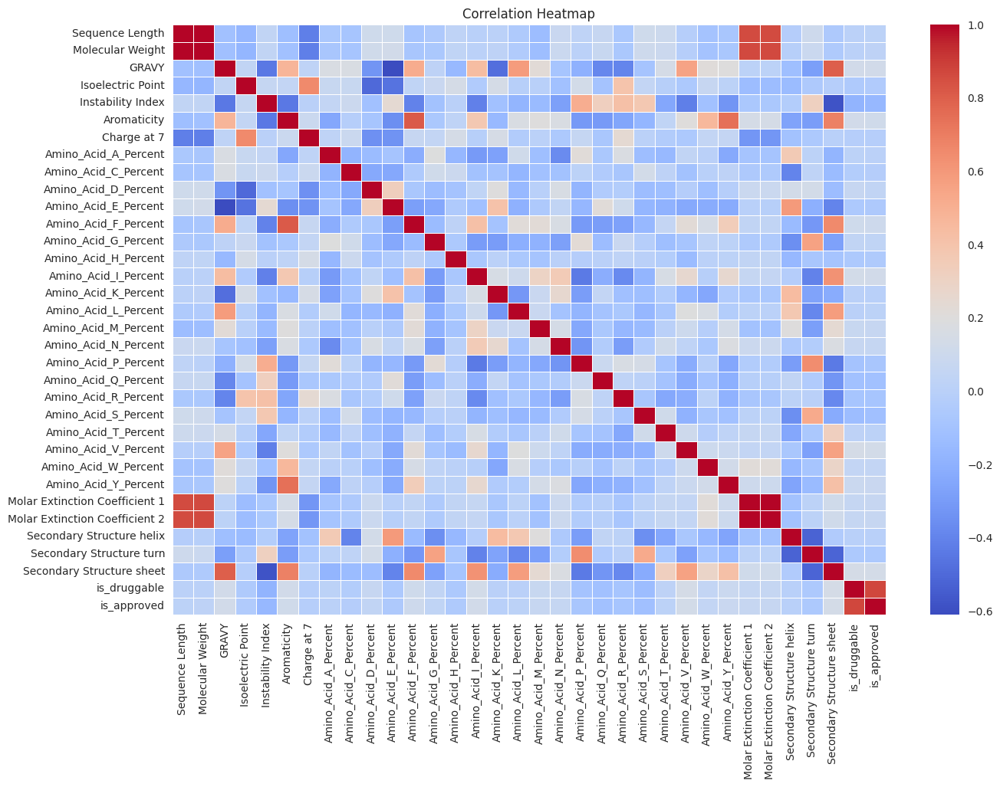

In [ ]:
plt.figure(figsize=(15, 10))
sns.heatmap(okk_1.corr(), cmap='coolwarm', annot=False, fmt=".2f",linewidth= 0.5)
plt.title('Correlation Heatmap')
plt.show()

In [ ]:
okk_1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 20434 entries, A0A087X1C5 to Q9Y6Z2
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Sequence Length                 20434 non-null  float64
 1   Molecular Weight                20434 non-null  float64
 2   GRAVY                           20434 non-null  float64
 3   Isoelectric Point               20434 non-null  float64
 4   Instability Index               20434 non-null  float64
 5   Aromaticity                     20434 non-null  float64
 6   Charge at 7                     20434 non-null  float64
 7   Amino_Acid_A_Percent            20434 non-null  float64
 8   Amino_Acid_C_Percent            20434 non-null  float64
 9   Amino_Acid_D_Percent            20434 non-null  float64
 10  Amino_Acid_E_Percent            20434 non-null  float64
 11  Amino_Acid_F_Percent            20434 non-null  float64
 12  Amino_Acid_G_Percent       

In [ ]:
#PCA Analysis for reduction and selection of relevant ones

n_components = 21
pca_list = []
feature_weight_list = []
for i in range(1,n_components):
  PCAmod = PCA(n_components = i)
  PCAmod.fit(okk_1.iloc[:,7:27])
  pca_list.append(pd.Series({
      "n" : i,
      "model" : PCAmod,
      "var" : PCAmod.explained_variance_ratio_.sum(),
  }))
  weights = PCAmod.explained_variance_ratio_.reshape(-1, 1) / PCAmod.explained_variance_ratio_.sum()
  overall_contributions = np.abs(PCAmod.components_) * weights
  abs_feature_values = overall_contributions.sum(axis=0)
  feature_weight_list.append(pd.DataFrame({
      'n': i,
      'features': okk_1.iloc[:,7:27].columns,
      'values': abs_feature_values / abs_feature_values.sum(),
  }))
pca_report = pd.DataFrame(pca_list)
feature_importance_report = pd.concat(feature_weight_list).pivot(index='n', columns='features', values='values')

In [ ]:
pca_report

,n,model,var
0,1,PCA(n_components=1),0.165048
1,2,PCA(n_components=2),0.291789
2,3,PCA(n_components=3),0.381773
3,4,PCA(n_components=4),0.446064
4,5,PCA(n_components=5),0.507438
5,6,PCA(n_components=6),0.556249
6,7,PCA(n_components=7),0.603241
7,8,PCA(n_components=8),0.647454
8,9,PCA(n_components=9),0.690123
9,10,PCA(n_components=10),0.730940


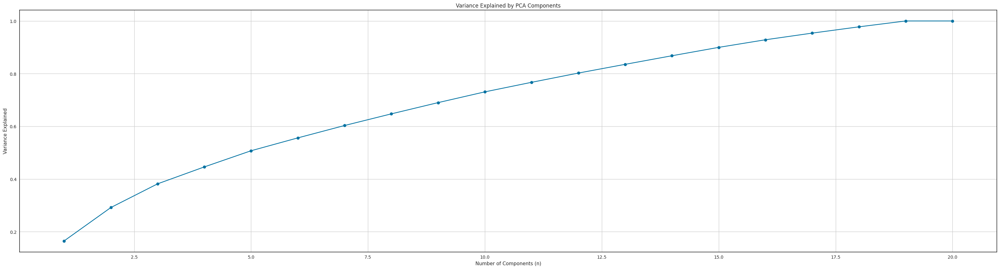

In [ ]:
fig,ax = plt.subplots(figsize = (40,10))
plt.plot(pca_report['n'], pca_report['var'], marker = 'o', linestyle = "-", color = 'b')
plt.title('Variance Explained by PCA Components')
# plt.axvline(x=150, color='r', linestyle='--', linewidth=2, label='Threshold at x=50')
plt.xlabel('Number of Components (n)')
plt.ylabel('Variance Explained')
plt.grid(True)
plt.show()

[Text(0.5, 0, 'Number of components'),
 Text(0, 0.5, 'Relative Importance'),
 Text(0.5, 1.0, 'Feature Importance Vs Dimensions')]

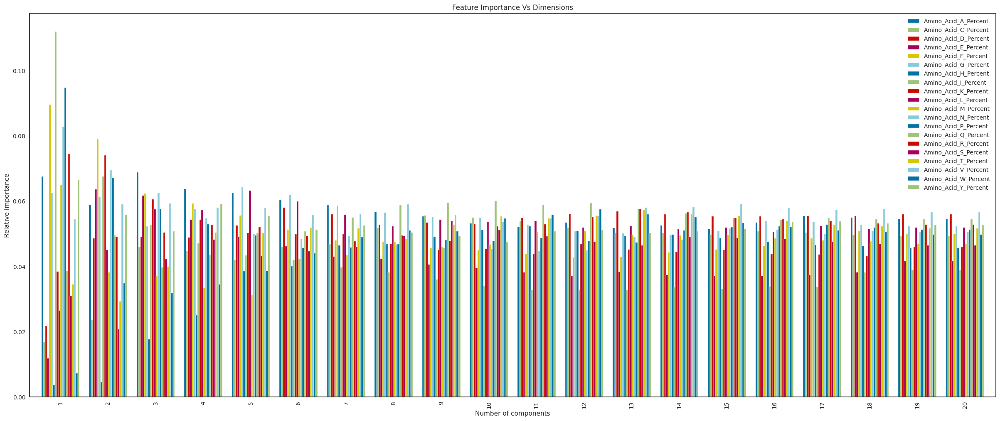

In [ ]:
ax = feature_importance_report.plot(kind = 'bar' , figsize = (30,12), width=0.8)
ax.legend(loc = 'upper right')
ax.set(xlabel = 'Number of components' ,  ylabel = 'Relative Importance' , title = 'Feature Importance Vs Dimensions')

<Figure size 2000x1200 with 0 Axes>

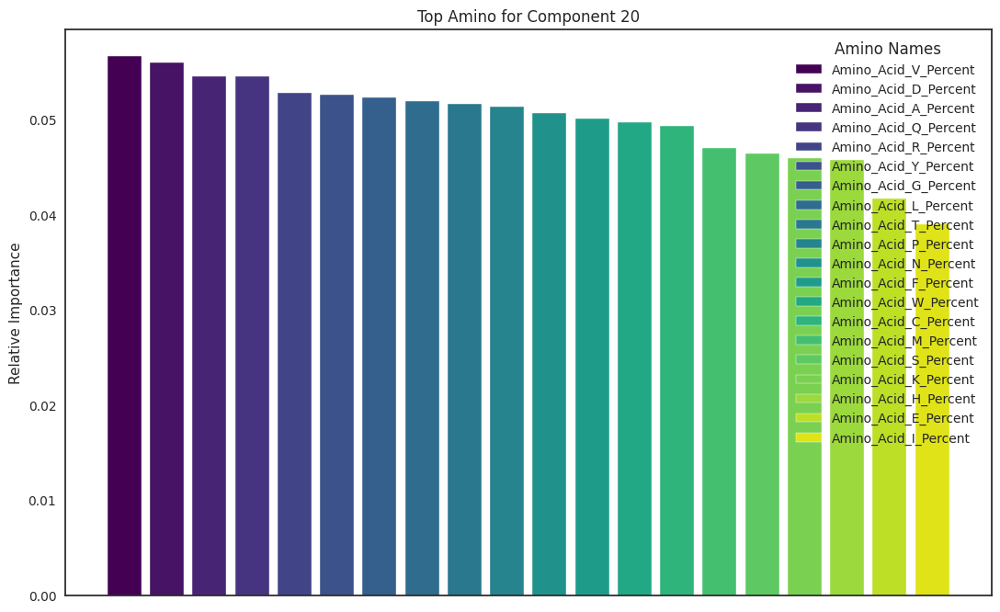

In [ ]:
plt.figure(figsize= (20,12))
n_top_amino = 20
top_amino_acids = feature_importance_report.iloc[19].nlargest(n_top_amino)
fig, ax = plt.subplots(figsize=(13, 8))

for idx, (amino, importance) in enumerate(top_amino_acids.items()):
    ax.bar(idx, importance, label=amino, color=plt.cm.viridis(idx / len(top_amino_acids)))

ax.set_xticks([])

ax.legend(loc='upper right', title='Amino Names')

ax.set(ylabel='Relative Importance', title='Top Amino for Component 20')
plt.show()

Amino_Acid_T_Percent              0.022023
Amino_Acid_E_Percent              0.023529
Isoelectric Point                 0.024071
Amino_Acid_I_Percent              0.024110
Amino_Acid_V_Percent              0.024113
Charge at 7                       0.024259
Amino_Acid_R_Percent              0.025353
Amino_Acid_N_Percent              0.025427
Amino_Acid_W_Percent              0.025452
Amino_Acid_F_Percent              0.026637
Amino_Acid_Y_Percent              0.027026
Amino_Acid_H_Percent              0.027291
Amino_Acid_P_Percent              0.027594
Secondary Structure helix         0.028121
Molar Extinction Coefficient 1    0.028330
Amino_Acid_L_Percent              0.028621
Amino_Acid_D_Percent              0.028660
Amino_Acid_C_Percent              0.028671
GRAVY                             0.029281
Amino_Acid_K_Percent              0.029306
Molar Extinction Coefficient 2    0.030263
Amino_Acid_M_Percent              0.031674
Amino_Acid_A_Percent              0.031737
Amino_Acid_

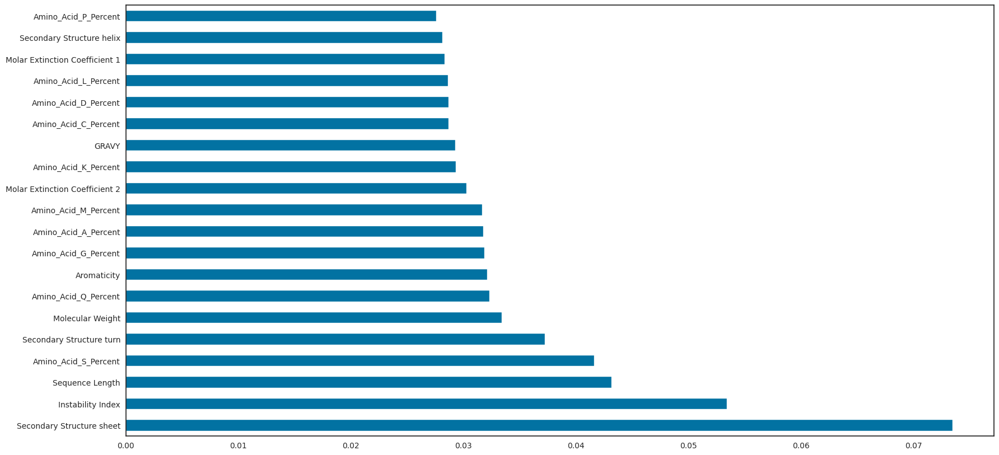

In [ ]:
#lets see each feature importance using XGB Classifier
import xgboost

x_sample = okk_1.drop(columns = ['is_druggable','is_approved'])
y_sample = okk_1['is_druggable']

model = xgboost.XGBClassifier()
model.fit(x_sample,y_sample)

feat_imp = pd.Series(model.feature_importances_, index=x_sample.columns)
print(feat_imp.sort_values())
feat_imp.nlargest(20).plot(kind='barh',figsize=(20,10))

plt.show()

In [ ]:
#model building
from sklearn.utils import resample
X_train,X_test,y_train,y_test = train_test_split(x_sample,y_sample, test_size = 0.2, random_state = 123)
oversample = SMOTE()
X_train,y_train = oversample.fit_resample(X_train,y_train)
sc = StandardScaler()

X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

#using xgboost boosting algorithms
model_1 = xgboost.XGBClassifier()
model_1.fit(X_train,y_train)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='binary:logistic', ...)

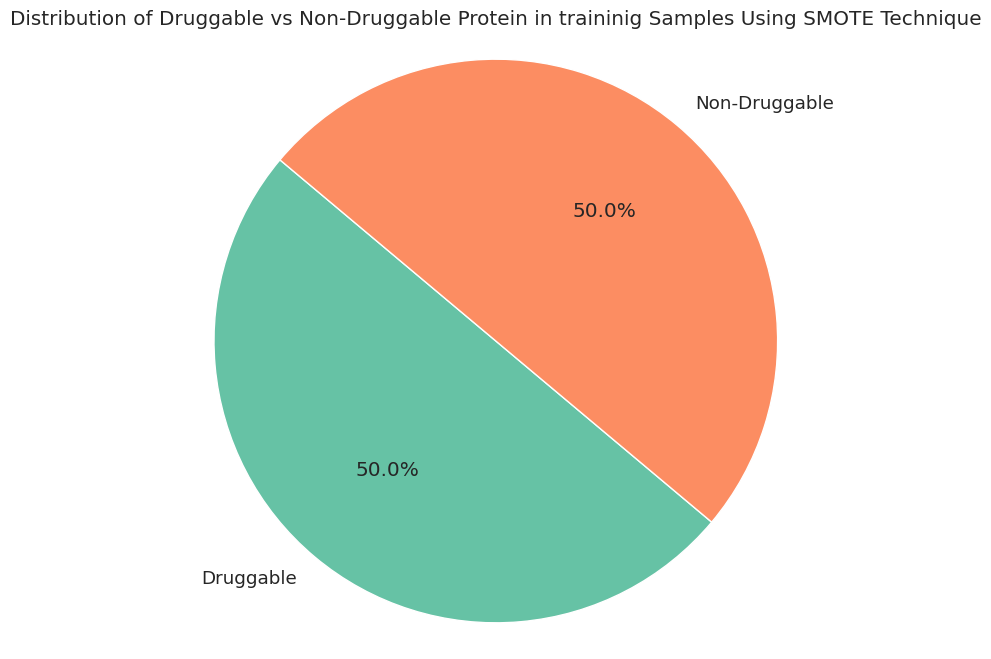

In [ ]:
druggable_counts = y_train.value_counts()
druggable_count = druggable_counts[1]
non_druggable_count = druggable_counts[0]

# Plotting
plt.figure(figsize=(8, 8))
plt.pie([druggable_count, non_druggable_count], labels=['Druggable', 'Non-Druggable'], autopct='%1.1f%%', startangle=140, colors=['#66c2a5', '#fc8d62'])
plt.title('Distribution of Druggable vs Non-Druggable Protein in traininig Samples Using SMOTE Technique')
plt.axis('equal')
plt.show()

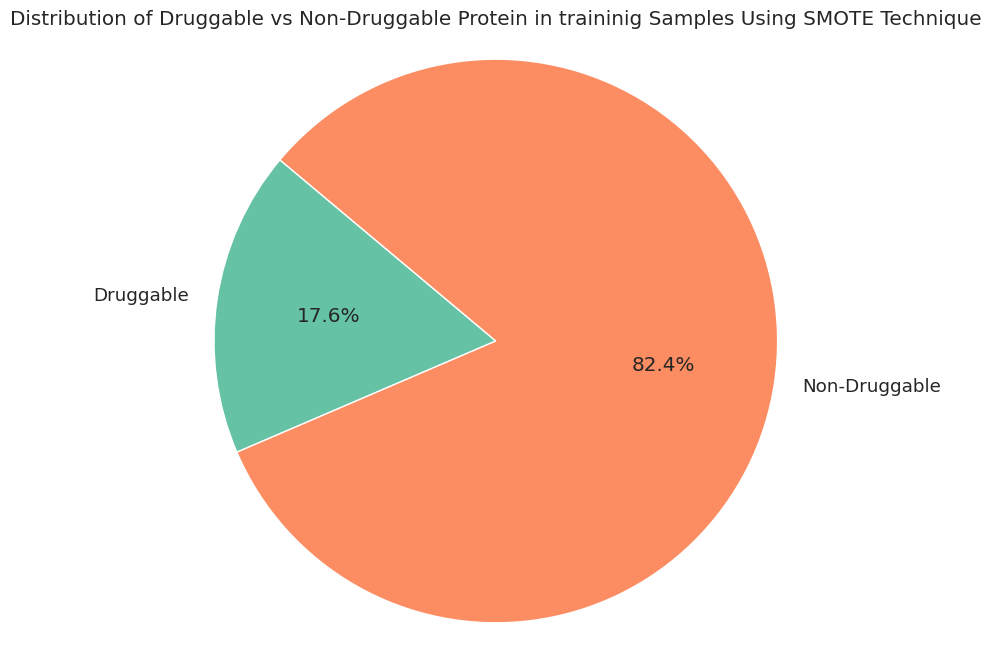

In [ ]:
druggable_counts = y_test.value_counts()
druggable_count = druggable_counts[1]
non_druggable_count = druggable_counts[0]

# Plotting
plt.figure(figsize=(8, 8))
plt.pie([druggable_count, non_druggable_count], labels=['Druggable', 'Non-Druggable'], autopct='%1.1f%%', startangle=140, colors=['#66c2a5', '#fc8d62'])
plt.title('Distribution of Druggable vs Non-Druggable Protein in traininig Samples Using SMOTE Technique')
plt.axis('equal')
plt.show()

In [ ]:
def test_results(y_pred, y_test):
  results = {}
  results['Accuracy'] = accuracy_score(y_test,y_pred)
  results['Precision'] = precision_score(y_test,y_pred,average = 'weighted')
  results['Recall'] = recall_score(y_test,y_pred,average = 'weighted')
  results['F1_Score'] = f1_score(y_test,y_pred,average = 'weighted')

  cm = confusion_matrix(y_test,y_pred)
  return results,cm

In [ ]:
y_pred = model_1.predict(X_test)
metrics_1,cm_1 = test_results(y_pred, y_test)

In [ ]:
#using logistic regression algorithm
model_2 = LogisticRegression()
model_2.fit(X_train,y_train)

LogisticRegression()

In [ ]:
y_pred_2 = model_2.predict(X_test)
metrics_2, cm_2 = test_results(y_pred_2, y_test)

In [ ]:
#using SVM algorithm using various kernels
model_3 = svm.SVC(kernel = 'linear',probability = True)
model_4 = svm.SVC(kernel = 'poly',probability = True)
model_5 = svm.SVC(kernel = 'rbf',probability = True)

model_3.fit(X_train,y_train)
model_4.fit(X_train,y_train)
model_5.fit(X_train,y_train)

SVC(probability=True)

In [ ]:
y_pred_3 = model_3.predict(X_test)
metrics_3, cm_3 = test_results(y_pred_3, y_test)

y_pred_4 = model_4.predict(X_test)
metrics_4, cm_4 = test_results(y_pred_4, y_test)

y_pred_5 = model_3.predict(X_test)
metrics_5, cm_5 = test_results(y_pred_5, y_test)

In [ ]:
#using RandomForest with estimator = 1500 which is no of trees employed
model_6 = RandomForestClassifier(n_estimators = 1500, criterion = 'entropy', random_state = 42)
model_6.fit(X_train,y_train)

RandomForestClassifier(criterion='entropy', n_estimators=1500, random_state=42)

In [ ]:
y_pred_6 = model_6.predict(X_test)
metrics_6,cm_6 = test_results(y_pred_6,y_test)

In [ ]:
#using ANN for classification
model_7 = tf.keras.Sequential([
    layers.Dense(64, activation='relu'),
    layers.Dense(128, activation='relu'),
    layers.Dense(256, activation='relu'),
    layers.Dropout(0.3),
    layers.BatchNormalization(),
    layers.Dense(1, activation='sigmoid')
])

# Compile model
model_7.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
history = model_7.fit(X_train, y_train, validation_data = (X_test,y_test), epochs = 50)

Epoch 1/50
858/858 [==============================] - 6s 4ms/step - loss: 0.5645 - accuracy: 0.7180 - val_loss: 0.6154 - val_accuracy: 0.6641
Epoch 2/50
858/858 [==============================] - 3s 3ms/step - loss: 0.5012 - accuracy: 0.7581 - val_loss: 0.5749 - val_accuracy: 0.7025
Epoch 3/50
858/858 [==============================] - 2s 3ms/step - loss: 0.4637 - accuracy: 0.7871 - val_loss: 0.5550 - val_accuracy: 0.7203
Epoch 4/50
858/858 [==============================] - 2s 3ms/step - loss: 0.4266 - accuracy: 0.8085 - val_loss: 0.5363 - val_accuracy: 0.7399
Epoch 5/50
858/858 [==============================] - 3s 4ms/step - loss: 0.3984 - accuracy: 0.8230 - val_loss: 0.5465 - val_accuracy: 0.7446
Epoch 6/50
858/858 [==============================] - 3s 4ms/step - loss: 0.3664 - accuracy: 0.8415 - val_loss: 0.6137 - val_accuracy: 0.7389
Epoch 7/50
858/858 [==============================] - 2s 3ms/step - loss: 0.3375 - accuracy: 0.8535 - val_loss: 0.5809 - val_accuracy: 0.7587
Epoch 

In [ ]:
y_pred_7 = model_7.predict(X_test)
y_pred_7 = (y_pred_7 >= 0.5).astype(int)
metrics_7,cm_7 = test_results(y_pred_7,y_test)

128/128 [==============================] - 1s 3ms/step


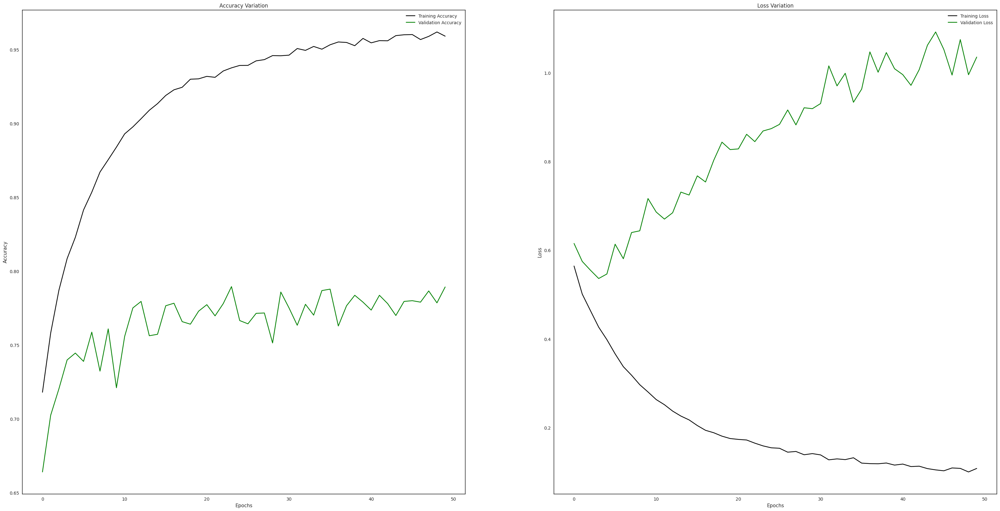

In [ ]:
fig,ax = plt.subplots(figsize = (40,20), ncols = 2)
ax[0].plot(history.history['accuracy'],color = 'black', label = 'Training Accuracy')
ax[0].plot(history.history['val_accuracy'],color = 'green', label = 'Validation Accuracy')
ax[0].set_ylabel('Accuracy')
ax[0].set_xlabel('Epochs')
ax[0].set_title('Accuracy Variation')
ax[0].legend()

ax[1].plot(history.history['loss'],color = 'black', label = 'Training Loss')
ax[1].plot(history.history['val_loss'],color = 'green', label = 'Validation Loss')
ax[1].set_ylabel('Loss')
ax[1].set_xlabel('Epochs')
ax[1].set_title('Loss Variation')
ax[1].legend()
plt.show()

In [ ]:
model_list = {
    "XGBoost" : pd.Series(metrics_1),
    "Logistic_Regression" : pd.Series(metrics_2),
    "SVM_Linear" : pd.Series(metrics_3),
    "SVM_Polynomial" : pd.Series(metrics_4),
    "SVM_RBF" : pd.Series(metrics_5),
    "Random_Forest" : pd.Series(metrics_6),
    "ANN" : pd.Series(metrics_7)
}

pd.DataFrame(model_list).T


,Accuracy,Precision,Recall,F1_Score
XGBoost,0.766088,0.798516,0.766088,0.779323
Logistic_Regression,0.631025,0.789212,0.631025,0.674823
SVM_Linear,0.614142,0.790916,0.614142,0.660234
SVM_Polynomial,0.609249,0.814545,0.609249,0.655382
SVM_RBF,0.614142,0.790916,0.614142,0.660234
Random_Forest,0.801566,0.806474,0.801566,0.803914
ANN,0.789332,0.789447,0.789332,0.789390


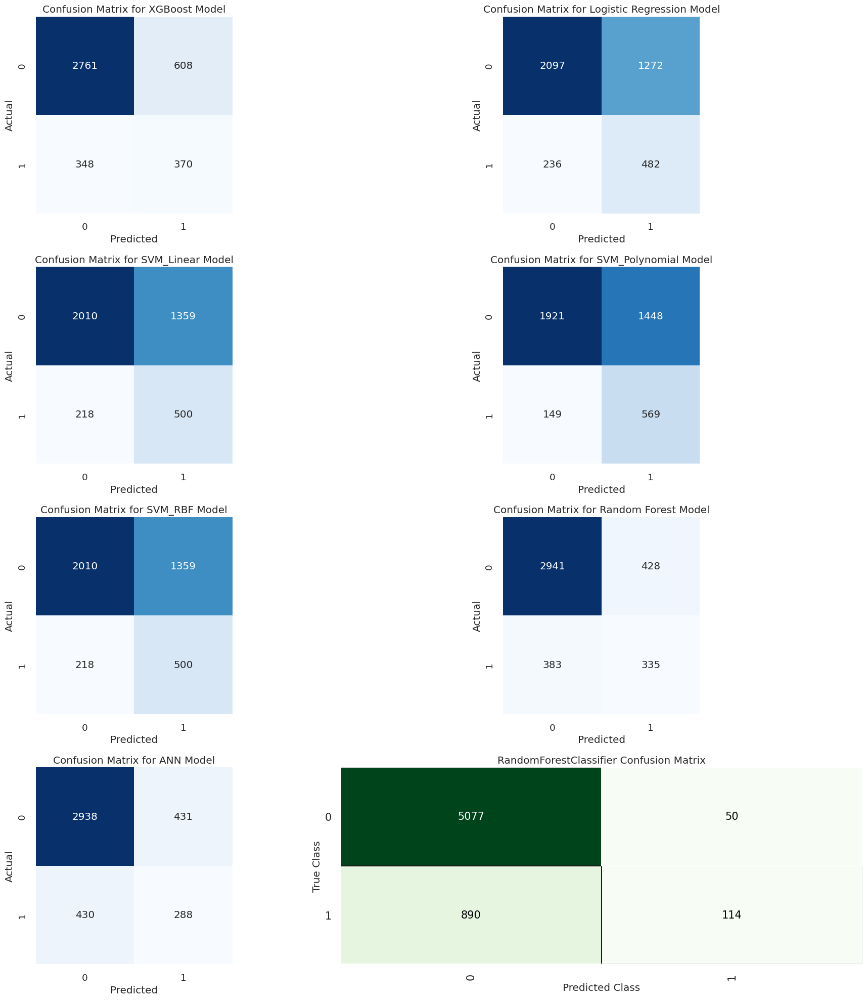

<Figure size 800x550 with 0 Axes>

In [ ]:
fig,ax = plt.subplots(figsize = (20,20), nrows = 4,ncols = 2)
sns.set(font_scale=1.2)  # Adjust font size if needed
sns.heatmap(cm_1, annot=True, fmt='d', cmap='Blues', cbar=False, square=True,ax = ax[0][0])
ax[0][0].set_xlabel('Predicted')
ax[0][0].set_ylabel('Actual')
ax[0][0].set_title('Confusion Matrix for XGBoost Model')

sns.heatmap(cm_2, annot=True, fmt='d', cmap='Blues', cbar=False, square=True,ax = ax[0][1])
ax[0][1].set_xlabel('Predicted')
ax[0][1].set_ylabel('Actual')
ax[0][1].set_title('Confusion Matrix for Logistic Regression Model')

sns.heatmap(cm_3, annot=True, fmt='d', cmap='Blues', cbar=False, square=True,ax = ax[1][0])
ax[1][0].set_xlabel('Predicted')
ax[1][0].set_ylabel('Actual')
ax[1][0].set_title('Confusion Matrix for SVM_Linear Model')

sns.heatmap(cm_4, annot=True, fmt='d', cmap='Blues', cbar=False, square=True,ax = ax[1][1])
ax[1][1].set_xlabel('Predicted')
ax[1][1].set_ylabel('Actual')
ax[1][1].set_title('Confusion Matrix for SVM_Polynomial Model')

sns.heatmap(cm_5, annot=True, fmt='d', cmap='Blues', cbar=False, square=True,ax = ax[2][0])
ax[2][0].set_xlabel('Predicted')
ax[2][0].set_ylabel('Actual')
ax[2][0].set_title('Confusion Matrix for SVM_RBF Model')

sns.heatmap(cm_6, annot=True, fmt='d', cmap='Blues', cbar=False, square=True,ax = ax[2][1])
ax[2][1].set_xlabel('Predicted')
ax[2][1].set_ylabel('Actual')
ax[2][1].set_title('Confusion Matrix for Random Forest Model')

sns.heatmap(cm_7, annot=True, fmt='d', cmap='Blues', cbar=False, square=True,ax = ax[3][0])
ax[3][0].set_xlabel('Predicted')
ax[3][0].set_ylabel('Actual')
ax[3][0].set_title('Confusion Matrix for ANN Model')

plot_model(best_models , plot = "confusion_matrix")
ax[3][1].set_xlabel('Predicted')
ax[3][1].set_ylabel('Actual')
ax[3][1].set_title('Confusion Matrix for Extra Trees Classifier Model using Pycaret AutoML')

plt.tight_layout()
plt.show()

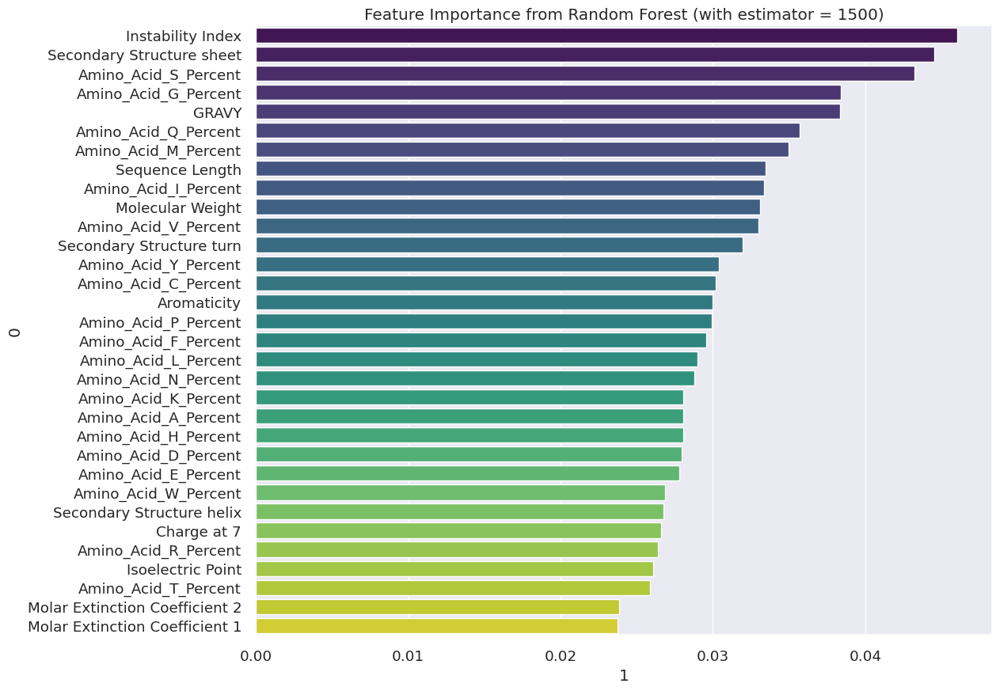

In [ ]:
feature_importance = model_6.feature_importances_
okk = pd.DataFrame([x_sample.columns, feature_importance]).T
okk = okk.sort_values(by = 1,ascending = False)
plt.figure(figsize=(12, 10))
sns.barplot(x = okk[1], y = okk[0], data = okk, palette='viridis')
plt.title("Feature Importance from Random Forest (with estimator = 1500)")
plt.show()

In [ ]:
import pycaret
pycaret.__version__

'3.3.0'

In [ ]:
from pycaret.classification import *
setup(data = x_sample, target = y_sample, session_id = 123)
best_models = compare_models()

,Description,Value
0,Session id,123
1,Target,is_druggable
2,Target type,Binary
3,Original data shape,"(20434, 33)"
4,Transformed data shape,"(20434, 33)"
5,Transformed train set shape,"(14303, 33)"
6,Transformed test set shape,"(6131, 33)"
7,Numeric features,32
8,Preprocess,True
9,Imputation type,simple


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.8456,0.7715,0.1098,0.6689,0.1880,0.1492,0.2264,7.5160
et,Extra Trees Classifier,0.8448,0.7833,0.0859,0.7176,0.1531,0.1224,0.2109,1.8390
lightgbm,Light Gradient Boosting Machine,0.8430,0.7715,0.1786,0.5668,0.2713,0.2092,0.2537,2.8540
gbc,Gradient Boosting Classifier,0.8425,0.7649,0.1222,0.5927,0.2023,0.1550,0.2163,13.7580
xgboost,Extreme Gradient Boosting,0.8399,0.7633,0.2302,0.5250,0.3194,0.2442,0.2713,1.2490
ada,Ada Boost Classifier,0.8364,0.7406,0.1239,0.5017,0.1982,0.1428,0.1871,2.6880
dummy,Dummy Classifier,0.8363,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0690
ridge,Ridge Classifier,0.8361,0.0000,0.0009,0.1500,0.0017,0.0007,0.0054,0.0660
lda,Linear Discriminant Analysis,0.8351,0.7141,0.0132,0.4004,0.0256,0.0151,0.0465,0.1600
lr,Logistic Regression,0.8348,0.7185,0.0201,0.3998,0.0381,0.0231,0.0576,0.7600


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

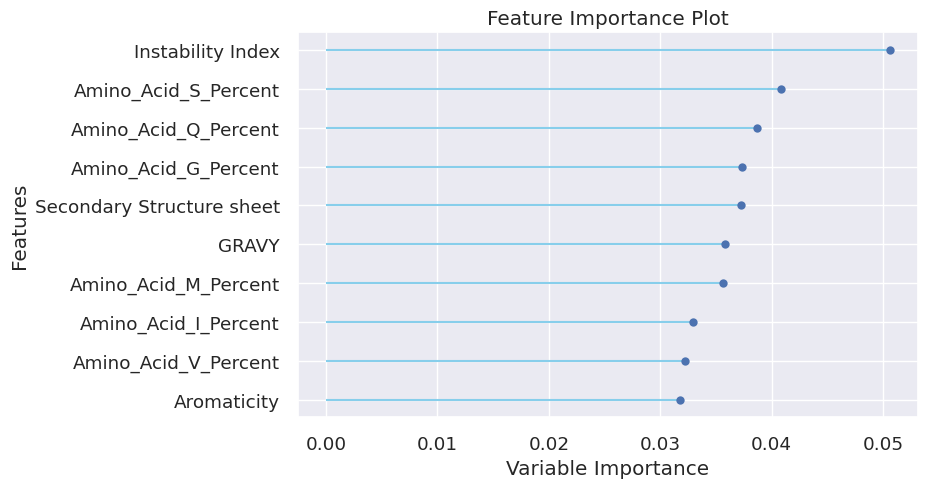

In [ ]:
plot_model(best_models, plot = 'feature')

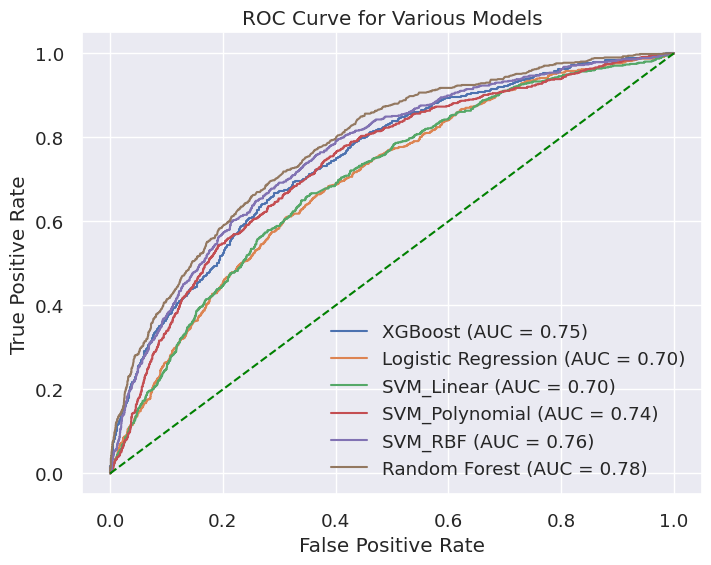

In [ ]:
#roc-auc curve for various algorithm
fpr_1, tpr_1, _ = roc_curve(y_test, model_1.predict_proba(X_test)[:, 1])
fpr_2, tpr_2, _ = roc_curve(y_test, model_2.predict_proba(X_test)[:, 1])
fpr_3, tpr_3, _ = roc_curve(y_test, model_3.predict_proba(X_test)[:, 1])
fpr_4, tpr_4, _ = roc_curve(y_test, model_4.predict_proba(X_test)[:, 1])
fpr_5, tpr_5, _ = roc_curve(y_test, model_5.predict_proba(X_test)[:, 1])
fpr_6, tpr_6, _ = roc_curve(y_test, model_6.predict_proba(X_test)[:, 1])

from sklearn.metrics import roc_auc_score

auc_1 = roc_auc_score(y_test, model_1.predict_proba(X_test)[:, 1])
auc_2 = roc_auc_score(y_test, model_2.predict_proba(X_test)[:, 1])
auc_3 = roc_auc_score(y_test, model_3.predict_proba(X_test)[:, 1])
auc_4 = roc_auc_score(y_test, model_4.predict_proba(X_test)[:, 1])
auc_5 = roc_auc_score(y_test, model_5.predict_proba(X_test)[:, 1])
auc_6 = roc_auc_score(y_test, model_6.predict_proba(X_test)[:, 1])

# Plot ROC curves for each model with AUC values in the legend
plt.figure(figsize=(8, 6))
plt.plot(fpr_1, tpr_1, label=f'XGBoost (AUC = {auc_1:.2f})')
plt.plot(fpr_2, tpr_2, label=f'Logistic Regression (AUC = {auc_2:.2f})')
plt.plot(fpr_3, tpr_3, label=f'SVM_Linear (AUC = {auc_3:.2f})')
plt.plot(fpr_4, tpr_4, label=f'SVM_Polynomial (AUC = {auc_4:.2f})')
plt.plot(fpr_5, tpr_5, label=f'SVM_RBF (AUC = {auc_5:.2f})')
plt.plot(fpr_6, tpr_6, label=f'Random Forest (AUC = {auc_6:.2f})')

# Plot the diagonal line (random classifier)
plt.plot([0, 1], [0, 1], color='green', linestyle='--')

# Set labels and title
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Various Models')
plt.legend()
plt.show()

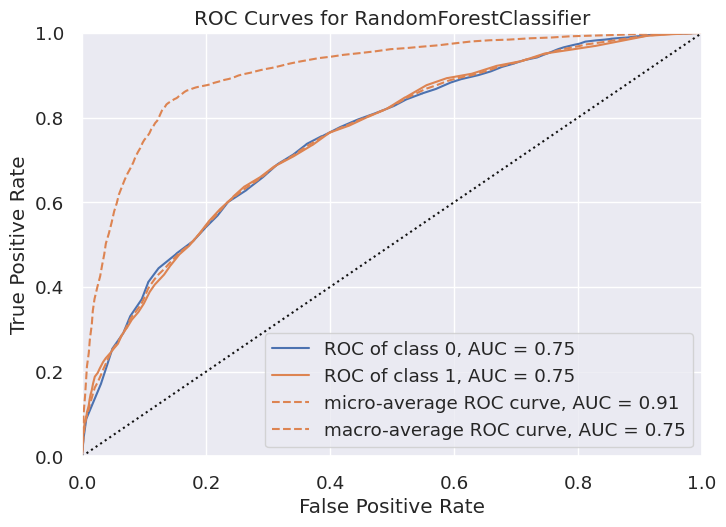

In [ ]:
plot_model(best_models, plot = 'auc')